In [1]:
import matplotlib.pyplot as plt
import skimage as sk
import numpy as np
import matplotlib.cm as cm
import matplotlib.patheffects as PathEffects
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

In [2]:
data = sk.data.cells3d()

In [3]:
data.shape

(60, 2, 256, 256)

In [4]:
# figure out image sizes
# figure out sizes in inches
Ny, Nx = data.shape[-2:]
Nz = data.shape[0]

# we want width to be 4 inches
w_in = 4.0
h_in = w_in * (Nx / Ny)

In [5]:
# get intensity ranges to clipping
low_ch1 = np.percentile(data[:,0], 1.0)
low_ch2 = np.percentile(data[:,1], 1.0)
hi_ch1 = np.percentile(data[:,0], 99.9)
hi_ch2 = np.percentile(data[:,1], 99.9)
norm_ch1 = plt.Normalize(vmin=low_ch1, vmax=hi_ch1, clip=True)
norm_ch2 = plt.Normalize(vmin=low_ch2, vmax=hi_ch2, clip=True)

# assign colormap
cmap1 = cm.bone
cmap2 = cm.pink

# you can also make a custom colormap

In [6]:
# make a color image overlay function
# for dark background, use `np.max`
# for light background, use `np.min` (for inverted colormaps)
def make_composite(imglist, cmaplist, normlist, projfun=np.max):
    wrk = []
    for img, cmap, norm in zip(imglist, cmaplist, normlist):
        wrk.append(cmap(norm(img, clip=True)))
    return projfun(np.stack(wrk, axis=3), axis=3)


In [7]:
composite = make_composite(
    [data[:,0], data[:,1]],
    [cmap1, cmap2],
    [norm_ch1, norm_ch2])

Animation size has reached 21038488 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


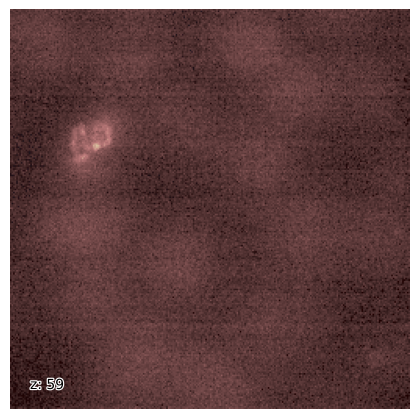

In [8]:
# setup Figure and Axes for drawing image
fig = plt.figure(frameon=False)
fig.set_size_inches(h_in, w_in)
ax = plt.Axes(fig, [0, 0, 1, 1])
ax.set_axis_off()
fig.add_axes(ax)

# show the first frame
im = ax.imshow(composite[0])
# add annotating text
frametxt = ax.text(0.05, 0.05, f"z: {0:d}", transform=ax.transAxes)
frametxt.set_path_effects(
    [PathEffects.withStroke(linewidth=1.7, foreground='w')]
)


def update_frame(i):
    # update image data
    im.set_data(composite[i])
    # update annotating text
    frametxt.set_text(f"z: {i:d}")
    
anim = FuncAnimation(fig, update_frame, frames=range(Nz))

# save animation to HTML format to later embedding
anim_html = anim.to_jshtml()

In [9]:
HTML(anim.to_jshtml())

In [10]:
with open('../images/cells3d_animation.html', 'w') as f:
    f.write(anim_html)

In [11]:
# alternatively you can also save this matplotlib 'animation' by directly saving into to a movie
import imageio
# if you're having issues with the image sizes 
# you may need to specify matplotlib.use('Agg')

with imageio.get_writer("../images/cells3d_movie.mp4", mode="I", fps=5) as writer:
    for i in range(Nz):
        update_frame(i)
        fig.canvas.draw()
        # grab the displayed image buffer from the figure and save as rgb array
        _img = np.frombuffer(fig.canvas.tostring_rgb(), dtype="uint8")
        _img = _img.reshape(fig.canvas.get_width_height()[::-1] + (3,))
        writer.append_data(_img)
